# Street Networks Analysis

# 1: Introduction

Urban street networks are complex spatial networks that evolve through planning decisions and community organization, and in turn shape human connections and interactions within the city. Street networks as spatial networks, has shown that structural model can provide insight into urban street structure, patterns of urban space and connectivity. Complex network analysis is a useful approach to quantitively research to inform and aid practicing planners.

This notebook is for assessing the complexity of the urban built form, specifically through its street networks. The topology includes complexity in terms of density and connectivity are applied in the study. In the analysis, the urban network in the area around Sydney CBD has been evaluated, the urban streets are regarded as edges, while the intersections are as nodes. 

# 2: Code

In [5]:
import networkx as nx
import osmnx as ox
import requests
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, LineString, Polygon
from descartes import PolygonPatch

ox.config(use_cache=True, log_console=True)

This section defines the study area and request data from open street map. The function "graph_from_place" can get the specific suburb from OSM. Then plot the graph to see the basic street network.

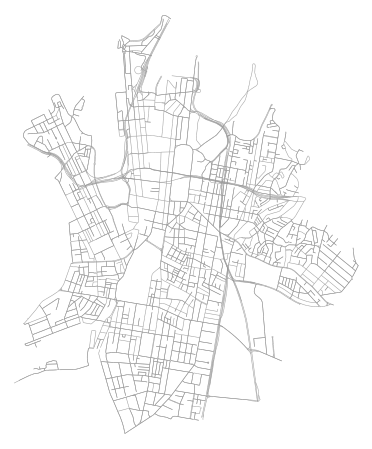

In [6]:
place = places = [{'city':'Sydney CBD', 'state':'New South Wales'}, 
                 {'city':'Millers Point', 'state':'New South Wales'},
                 {'city':'Dawes Point', 'state':'New South Wales'},
                 {'city':'Barangaroo', 'state':'New South Wales'},
                 {'city':'Pyrmont', 'state':'New South Wales'},
                 {'city':'Ultimo', 'state':'New South Wales'},
                 {'city':'Haymarket', 'state':'New South Wales'},
                 {'city':'Chippendale', 'state':'New South Wales'},
                 {'city':'Surry Hills', 'state':'New South Wales'},
                 {'city':'Darlinghurst', 'state':'New South Wales'},
                 {'city':'Woolloomooloo', 'state':'New South Wales'},
                 {'city':'Potts Point', 'state':'New South Wales'},
                 {'city':'Elizabeth Bay', 'state':'New South Wales'},
                 {'city':'Rushcutters Bay', 'state':'New South Wales'},
                 {'city':'Paddington', 'state':'New South Wales'},
                 {'city':'Moore Park', 'state':'New South Wales'},
                 {'city':'Redfern', 'state':'New South Wales'},
                 {'city':'Waterloo', 'state':'New South Wales'},
                 {'city':'Darlington', 'state':'New South Wales'},
                 {'city':'Eveleigh', 'state':'New South Wales'}]
G0 = ox.graph_from_place(place, network_type='drive', simplify=False)
fig, ax = ox.plot_graph(G0, figsize=(12,8), node_size=0, edge_linewidth=0.5, bgcolor='white')

Project the study area from lat_long to the UTM zone appropriate for the geographic location. Then calculate the graph area.

In [7]:
G0_proj = ox.project_graph(G0)
nodes_proj = ox.graph_to_gdfs(G0_proj, edges=False)
graph_area_m = nodes_proj.unary_union.convex_hull.area
print('The area of the region is {:.1f} sqkm'.format(graph_area_m/1000000))

The area of the region is 19.6 sqkm


Then save the street network as GraphML file into the local disk and reload it.

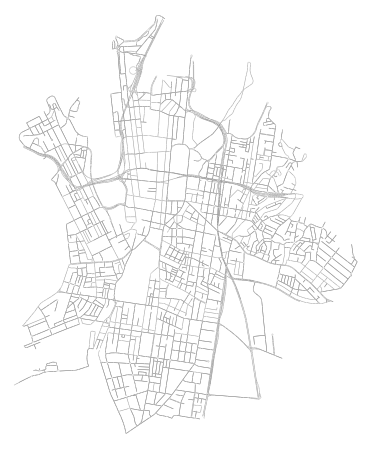

In [8]:
ox.save_graphml(G0_proj, filepath='network.graphml',)

G = ox.load_graphml('network.graphml')
fig, ax = ox.plot_graph(G, figsize=(12,8), node_size=0.2, edge_linewidth=0.5, bgcolor='white')

There could be some unnecessary nodes in the street network. This step is to clear the redundant points to make the process quicker.

If the node in the network is a true endpoint, the code will return boolean "True" to separate them with different color. Then use "simplify" to remove all nodes that are not intersections or dead-ends.

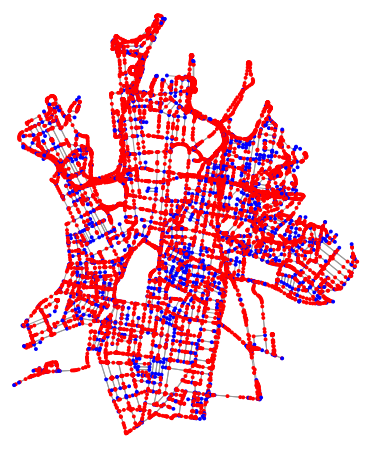

In [9]:
# turn off strict mode and see what nodes we'd remove, in red
nc = ['b' if ox.simplification._is_endpoint(G, node) else 'r' for node in G.nodes()]
fig, ax = ox.plot_graph(G, node_color=nc, node_zorder=3, bgcolor='white')

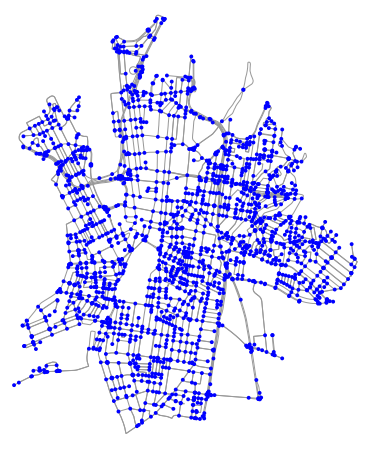

In [10]:
# simplify the network
G = ox.simplify_graph(G)
fig, ax = ox.plot_graph(G, node_color='b', node_zorder=3, bgcolor='white')

Divided roads are represented by separate centerline edges. The intersection of two divided roads thus creates 4 nodes, representing where each edge intersects a perpendicular edge. These 4 nodes represent a single intersection in the real world.  This step is to clean up the intersections and extract their xy coordinates.

This is the final step to prepare the data.

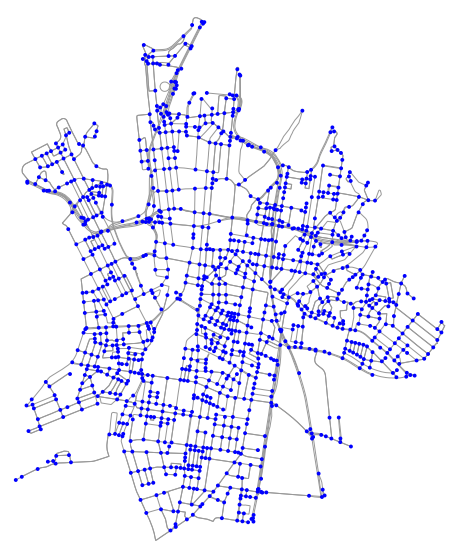

In [11]:
G2 = ox.simplification.consolidate_intersections(G, tolerance=15, dead_ends=False, rebuild_graph='true')
fig, ax = ox.plot_graph(G2, figsize=(12,10), show=False, close=False, node_alpha=1, bgcolor='white', node_color='b', node_zorder = 3)

OSMNx library easily analyzes networks and calculates network statistics, including spatial metrics based on geographic area or weighted by distance. 

Looking across the data set provides a sense of the Sydney CBD street networks. There are 2138 nodes and 288,010 meters of linear street in the study area. However, some of the data is hard to interpret which requires a further visualisation for better undersanding the street network.

In [12]:
# calculate basic and extended network stats, merge them together, and display
stats = ox.basic_stats(G2)
extended_stats = ox.extended_stats(G2, ecc=True, bc=True, cc=True)
for key, value in extended_stats.items():
    stats[key] = value
pd.Series(stats)

n                                                                                   1272
m                                                                                   3213
k_avg                                                                           5.051887
intersection_count                                                                   990
streets_per_node_avg                                                            2.482704
streets_per_node_counts                       {0: 0, 1: 0, 2: 46, 3: 723, 4: 208, 5: 13}
streets_per_node_proportion            {0: 0.0, 1: 0.0, 2: 0.036163522012578615, 3: 0...
edge_length_total                                                          384551.260891
edge_length_avg                                                               119.686044
street_length_total                                                        263129.110067
street_length_avg                                                             126.687102
street_segments_count

# 3: Visualise Centrality

Calculate the closeness centrality of nodes and edges. Nodes colored by closeness centrality from lowest (dark) to highest (light) for flows originating from and traveling to nodes within the subset.

Measures of centrality indicate the most important nodes in a network. Closeness centrality represents, for each node, the reciprocal of the sum of the distance from this node to all others in the network. Node rank as more central if they are averagely closer to all other nodes. This implies that the larger the distance between a node and all other nodes, the less “close” this node is to the network as a whole, and vice versa, the less the mean geodesic distance between them, the closer this node to the others.

To see in the graph, the nodes in the central has a higher closeness centrality than other node. However, this analysis only calculate the centrality inside the study area, which means the surrounding nodes may be affected due to this limitation. Furthermore, the data from OSM only includes the street which has a tag of road or street. The inner path of hyde park are excluded from the data source which need further process to increase the accuracy.

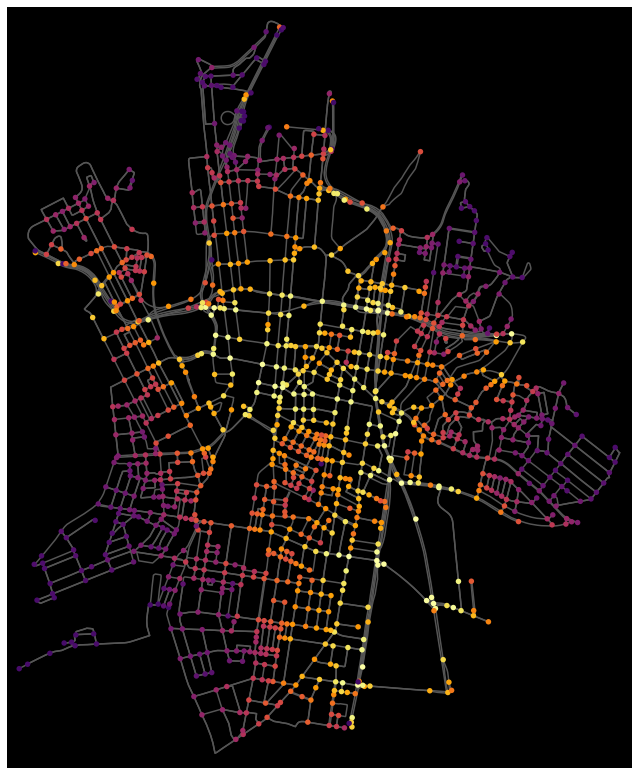

In [13]:
# node closeness centrality
node_centrality = nx.closeness_centrality(G2)

# plot it
df = pd.DataFrame(data=pd.Series(node_centrality).sort_values(), columns=['cc'])
df['colors'] = ox.plot.get_colors(n=len(df), cmap='inferno', start=0.2)
df = df.reindex(G2.nodes())
nc = df['colors'].tolist()
fig, ax = ox.plot_graph(G2,figsize=(16,14), bgcolor='k', node_size=30, node_color=nc, node_edgecolor='none', node_zorder=2,
                        edge_color='#555555', edge_linewidth=1.5, edge_alpha=1)

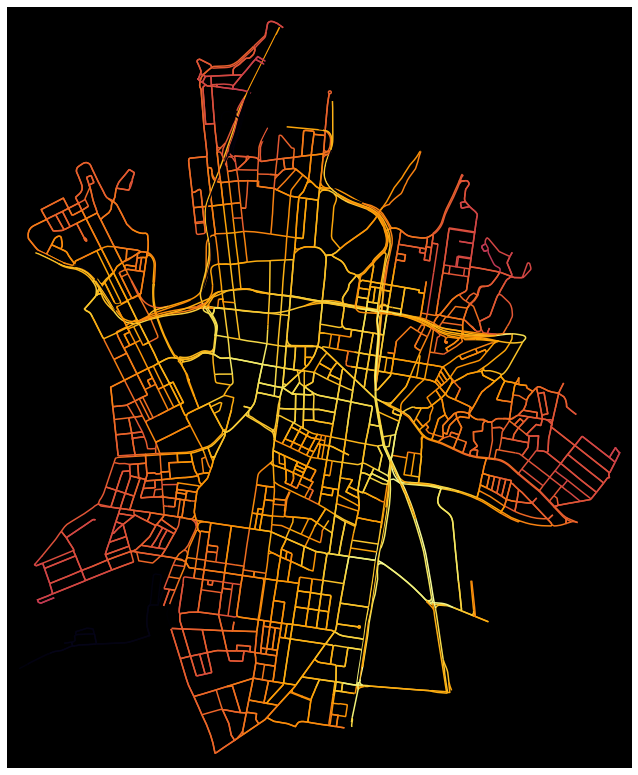

In [14]:
edge_centrality = nx.closeness_centrality(nx.line_graph(G2))

# list of edge values for the orginal graph
ev = [edge_centrality[edge + (0,)] for edge in G2.edges()]

# color scale converted to list of colors for graph edges
norm = colors.Normalize(vmin=min(ev)*0.8, vmax=max(ev))
cmap = cm.ScalarMappable(norm=norm, cmap=cm.inferno)
ec = [cmap.to_rgba(cl) for cl in ev]

# color the edges in the original graph with closeness centralities in the line graph
fig, ax = ox.plot_graph(G2, bgcolor='k', figsize=(16,14), node_size=0,
                        edge_color=ec, edge_linewidth=1.5, edge_alpha=1)

Betweenness centrality assesses the importance of a node by evaluating the number of shortest paths that pass through it. The maximum betweenness centrality in a network specifies the proportion of shortest paths that pass through the most important node.  Nodes or moves with high betweenness may have considerable influence in a network because they can control the “flow” in the network. This is an indicator of resilience: networks with a high maximum betweenness centrality are more prone to failure or inefficiency should this single choke point fail.

In [15]:
#Inspect betweenness centrality
G2_projected = ox.projection.project_graph(G2, to_crs='wgs84')
max_node, max_bc = max(extended_stats['betweenness_centrality'].items(), key=lambda x: x[1])
max_node, max_bc

(701, 0.16309248716058408)

From this graph, we can see the node with the maximum betweenness centrality. It explained why eastern distributor always in heavy traffic.

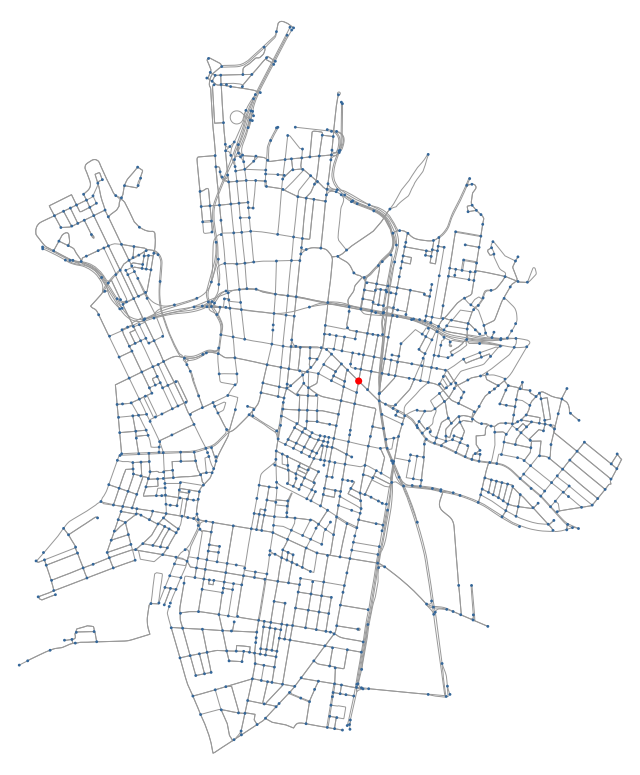

In [16]:
nc = ['r' if node==max_node else '#336699' for node in G2_projected.nodes()]
ns = [50 if node==max_node else 8 for node in G2_projected.nodes()]
fig, ax = ox.plot_graph(G2_projected,figsize=(16,14), node_size=ns, node_color=nc, node_zorder=2, bgcolor='w')

The betweenness centrality capturesthe series of nodes forming skeletal paths that define the structure of the network, signifying that the most number of shortest paths in the network pass through these nodes. 

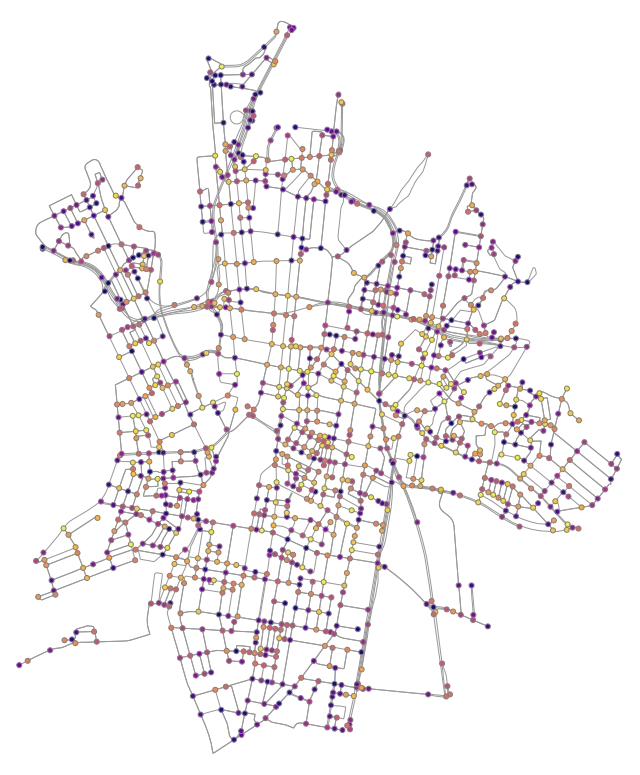

In [17]:
# get a color for each node
def get_color_list(n, color_map='plasma', start=0, end=1):
    return [cm.get_cmap(color_map)(x) for x in np.linspace(start, end, n)]

def get_node_colors_by_stat(G, data, start=0, end=1):
    df = pd.DataFrame(data=pd.Series(data).sort_values(), columns=['value'])
    df['colors'] = get_color_list(len(df), start=start, end=end)
    df = df.reindex(G2.nodes())
    return df['colors'].tolist()

nc = get_node_colors_by_stat(G2_projected, data=extended_stats['betweenness_centrality'])
fig, ax = ox.plot_graph(G2_projected,figsize=(16,14), node_color=nc, node_edgecolor='gray', node_size=25, node_zorder=2, bgcolor='w')

# 4: Isochrone Map 

Isochrone maps are commonly used to depict areas of equal travel time. This map plot the nodes that can be reached on foot in 5,10,15,20,25 minutes, measuring the walkability of the study area.

In [18]:
# configure the place, network type, trip times, and travel speed
place = 'Sydney, New South Wales, Australia'
network_type = 'walk'
trip_times = [5, 10, 15, 20, 25] #in minutes
travel_speed = 4.5 #walking speed in km/hour

In [19]:
# find the centermost node and then project the graph to UTM
gdf_nodes = ox.graph_to_gdfs(G, edges=False)
x, y = gdf_nodes['geometry'].unary_union.centroid.xy
center_node = ox.get_nearest_node(G, (y[0], x[0]),  method='euclidean')
G2 = ox.project_graph(G2, to_crs='wgs84')

In [20]:
# add an edge attribute for time in minutes required to traverse each edge
meters_per_minute = travel_speed * 1000 / 60 #km per hour to m per minute
for u, v, k, data in G.edges(data=True, keys=True):
    data['time'] = data['length'] / meters_per_minute

In [21]:
# get one color for each isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), cmap='Reds', start=0.3, return_hex=True)

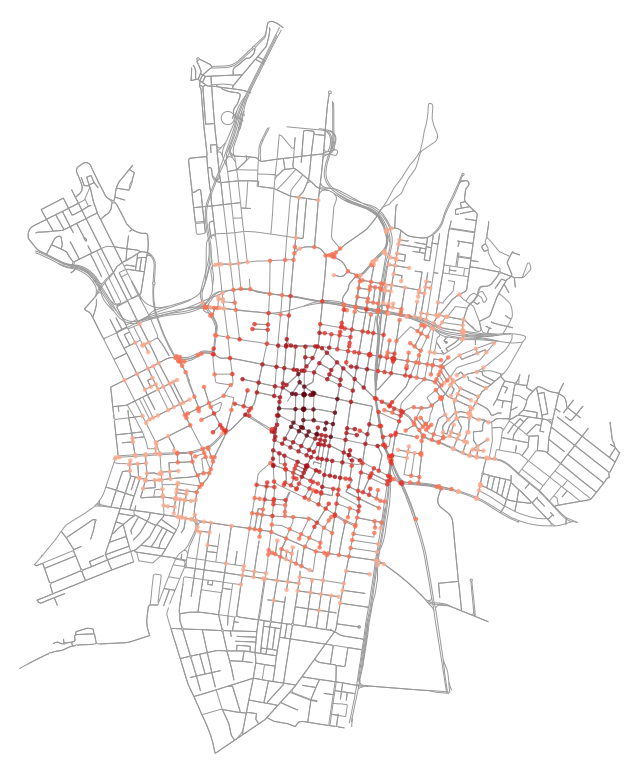

In [22]:
# color the nodes according to isochrone then plot the street network
node_colors = {}
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    subgraph = nx.ego_graph(G, center_node, radius=trip_time, distance='time')
    for node in subgraph.nodes():
        node_colors[node] = color
nc = [node_colors[node] if node in node_colors else 'none' for node in G.nodes()]
ns = [20 if node in node_colors else 0 for node in G.nodes()]
fig, ax = ox.plot_graph(G, figsize=(16,14), node_color=nc, node_size=ns, node_alpha=0.8, node_zorder=2,bgcolor='w')

Create polygons for the isochrone map.

In [23]:
# make the isochrone polygons
isochrone_polys = []
for trip_time in sorted(trip_times, reverse=True):
    subgraph = nx.ego_graph(G, center_node, radius=trip_time, distance='time')
    node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
    bounding_poly = gpd.GeoSeries(node_points).unary_union.convex_hull
    isochrone_polys.append(bounding_poly)

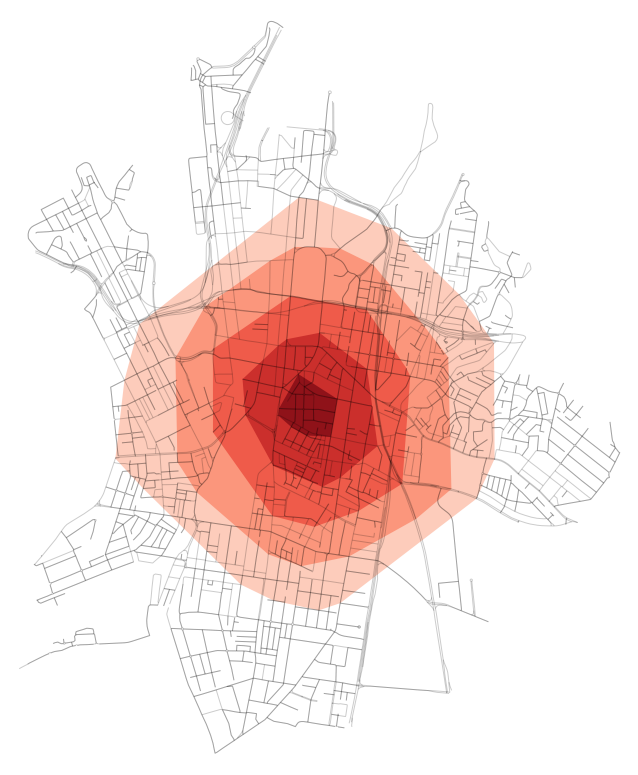

In [24]:
# plot the network then add isochrones as colored descartes polygon patches
fig, ax = ox.plot_graph(G, figsize=(16,14), show=False, close=False, edge_color='k', edge_alpha=0.2, node_color='none',bgcolor='w')
for polygon, fc in zip(isochrone_polys, iso_colors):
    patch = PolygonPatch(polygon, fc=fc, ec='none', alpha=0.6, zorder=-1)
    ax.add_patch(patch)
plt.show()

Create a geometry skeleton of the accessible area. Then allow for a parameterized buffer radius that is then applied to the constructed skeleton to ensure  a single, complex polygon object is generated to represent more detailed travel distance.

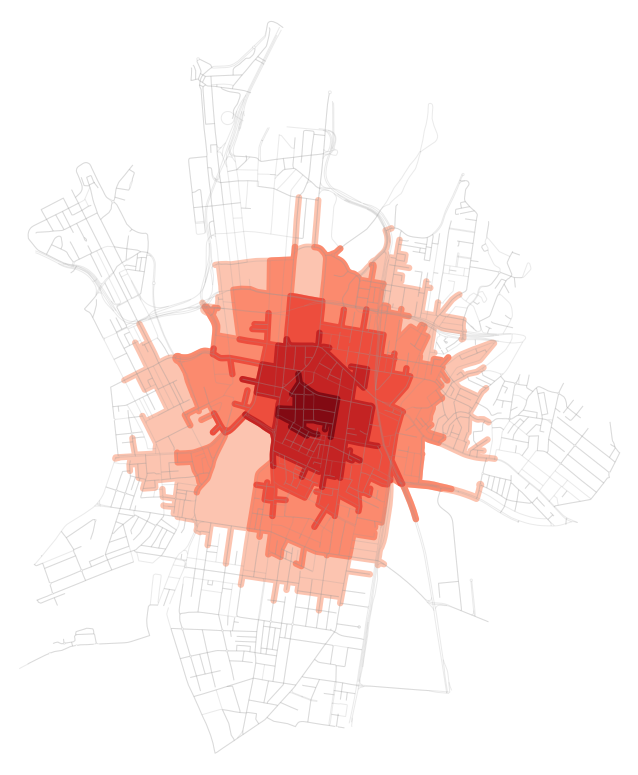

In [25]:
def make_iso_polys(G, edge_buff=25, node_buff=50, infill=False):
    isochrone_polys = []
    for trip_time in sorted(trip_times, reverse=True):
        subgraph = nx.ego_graph(G, center_node, radius=trip_time, distance='time')

        node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
        nodes_gdf = gpd.GeoDataFrame({'id': list(subgraph.nodes)}, geometry=node_points)
        nodes_gdf = nodes_gdf.set_index('id')

        edge_lines = []
        for n_fr, n_to in subgraph.edges():
            f = nodes_gdf.loc[n_fr].geometry
            t = nodes_gdf.loc[n_to].geometry
            edge_lookup = G.get_edge_data(n_fr, n_to)[0].get('geometry',  LineString([f,t]))
            edge_lines.append(edge_lookup)

        n = nodes_gdf.buffer(node_buff).geometry
        e = gpd.GeoSeries(edge_lines).buffer(edge_buff).geometry
        all_gs = list(n) + list(e)
        new_iso = gpd.GeoSeries(all_gs).unary_union
        
        # try to fill in surrounded areas so shapes will appear solid and blocks without white space inside them
        if infill:
            new_iso = Polygon(new_iso.exterior)
        isochrone_polys.append(new_iso)
    return isochrone_polys

isochrone_polys = make_iso_polys(G, edge_buff=25, node_buff=0, infill=True)
fig, ax = ox.plot_graph(G, figsize=(16,14), bgcolor='w', show=False, close=False, edge_color='#999999', edge_alpha=0.2, node_size=0)
for polygon, fc in zip(isochrone_polys, iso_colors):
    patch = PolygonPatch(polygon, fc=fc, ec='none', alpha=0.7, zorder=-1)
    ax.add_patch(patch)
plt.show()

# 5: Network Orientations

Compare the spatial orientations of the city street network in Sydney CBD.

Kevin Lynch defined "legible” cities as those whose patterns lend themselves to coherent, organized, recognizable, and comprehensible mental images. These help us organize city space into cognitive maps for wayfinding and a sense of place.

In [26]:
# define the study sites as label : query
places = {'Sydney CBD'       : 'Sydney CBD, NSW, AU',
          'Paddington'       : 'Paddington, NSW, AU',
          'Surry Hills'       : 'Surry Hills, NSW, AU',
          'Darlinghurst'       : 'Darlinghurst, NSW, AU',
         'Pyrmont'       : 'Pyrmont, NSW, AU',
          'Haymarket'       : 'Haymarket, NSW, AU'}

In [27]:
# verify OSMnx geocodes each query to what you expect
gdf = ox.gdf_from_places(places.values())
gdf.head()

AttributeError: module 'osmnx' has no attribute 'gdf_from_places'

In [25]:
def reverse_bearing(x):
    return x + 180 if x < 180 else x - 180

In [26]:
weight_by_length = False

In [27]:
bearings = {}

for place in sorted(places.keys()):
    
    # get the graph
    query = places[place]
    G = ox.graph_from_place(query, network_type='drive')
    
    # calculate edge bearings
    Gu = ox.add_edge_bearings(ox.get_undirected(G))
    
    if weight_by_length:
        # weight bearings by length (meters)
        city_bearings = []
        for u, v, k, d in Gu.edges(keys=True, data=True):
            city_bearings.extend([d['bearing']] * int(d['length']))
        b = pd.Series(city_bearings)
        bearings[place] = pd.concat([b, b.map(reverse_bearing)]).reset_index(drop='True')
    else:
        b = pd.Series([d['bearing'] for u, v, k, d in Gu.edges(keys=True, data=True)])
        bearings[place] = pd.concat([b, b.map(reverse_bearing)]).reset_index(drop='True')

In [28]:
def count_and_merge(n, bearings):
    # make twice as many bins as desired, then merge them in pairs
    # prevents bin-edge effects around common values like 0° and 90°
    n = n * 2
    bins = np.arange(n + 1) * 360 / n
    count, _ = np.histogram(bearings, bins=bins)
    
    # move the last bin to the front, so eg 0.01° and 359.99° will be binned together
    count = np.roll(count, 1)
    return count[::2] + count[1::2]

In [29]:
# function to draw a polar histogram for a set of edge bearings
def polar_plot(ax, bearings, n=36, title=''):

    bins = np.arange(n + 1) * 360 / n
    count = count_and_merge(n, bearings)
    _, division = np.histogram(bearings, bins=bins)
    frequency = count / count.sum()
    division = division[0:-1]
    width =  2 * np.pi / n

    ax.set_theta_zero_location('N')
    ax.set_theta_direction('clockwise')

    x = division * np.pi / 180
    bars = ax.bar(x, height=frequency, width=width, align='center', bottom=0, zorder=2,
                  color='#003366', edgecolor='k', linewidth=0.5, alpha=0.7)
    
    ax.set_ylim(top=frequency.max())
    
    title_font = {'family':'Century Gothic', 'size':24, 'weight':'bold'}
    xtick_font = {'family':'Century Gothic', 'size':10, 'weight':'bold', 'alpha':1.0, 'zorder':3}
    ytick_font = {'family':'Century Gothic', 'size': 9, 'weight':'bold', 'alpha':0.2, 'zorder':3}
    
    ax.set_title(title.upper(), y=1.05, fontdict=title_font)
    
    ax.set_yticks(np.linspace(0, max(ax.get_ylim()), 5))
    yticklabels = ['{:.2f}'.format(y) for y in ax.get_yticks()]
    yticklabels[0] = ''
    ax.set_yticklabels(labels=yticklabels, fontdict=ytick_font)
    
    xticklabels = ['N', '', 'E', '', 'S', '', 'W', '']
    ax.set_xticklabels(labels=xticklabels, fontdict=xtick_font)
    ax.tick_params(axis='x', which='major', pad=-2)

Each of the suburbs is represented by a polar histogram depicting how its streets orient. Each bar’s direction represents the compass bearings of the streets and its length represents the relative frequency of streets with those bearings.

As seen from the plots, Sydney suburbs adhere pretty well to a north-south, east-west grid.  Although it features a grid in some neighborhoods like the Paddington or Haymarket and, these grids tend to not be aligned with one another, resulting in irregular competing orientations. Furthermore, these grids are constrained by the rail track in many directions.

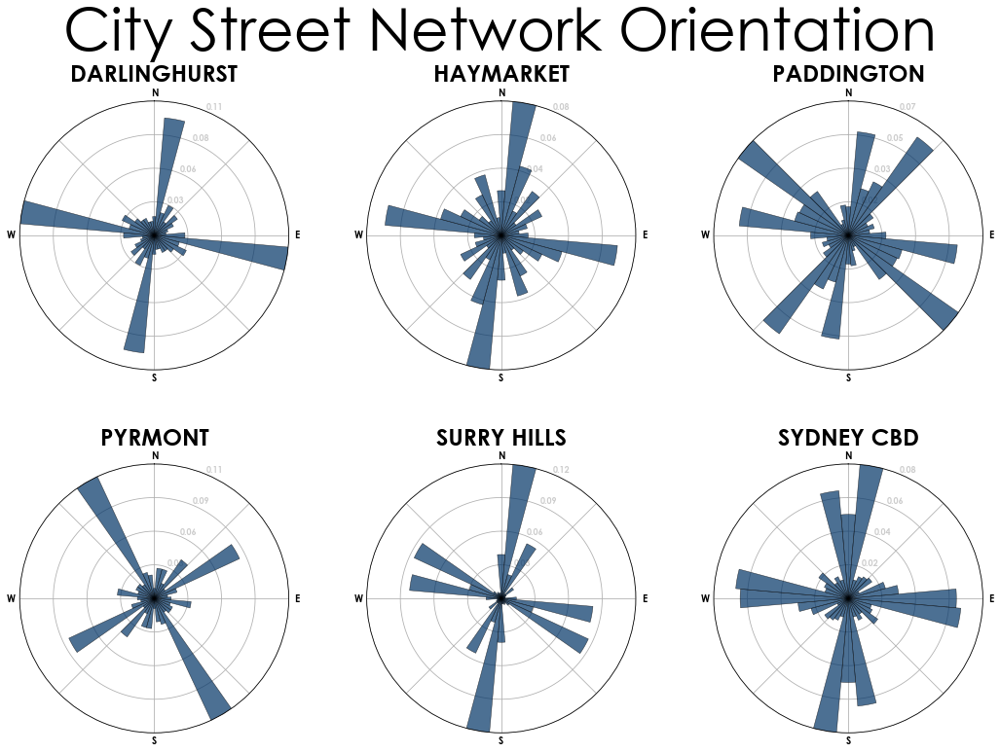

In [30]:
# create figure and axes
n = len(places)
ncols = int(np.ceil(np.sqrt(n)))
nrows = int(np.ceil(n / ncols))
figsize = (ncols * 5, nrows * 5)
fig, axes = plt.subplots(nrows, ncols, figsize=figsize, subplot_kw={'projection':'polar'})

# plot each city's polar histogram
for ax, place in zip(axes.flat, sorted(places.keys())):
    polar_plot(ax, bearings[place].dropna(), title=place)

# add super title and save full image
suptitle_font = {'family':'Century Gothic', 'fontsize':60, 'fontweight':'normal', 'y':1.07}
fig.suptitle('City Street Network Orientation', **suptitle_font)
fig.tight_layout()
fig.subplots_adjust(hspace=0.35)
#plt.close()

# 6: Conclusion

The street network analysis presented insight for the urban built form and street connectivity for the suburbs around Sydney CBD. Centralityeis of different types can bring out the well-connected and important nodes and edges in a master plan, and could serve city planning, design and management as an analysis methods. Performing the centrality analysis for the different surburb of the city will permit analysis the of how street structure changes in different urban context. In the future, the analysis of centrality will be useful in figure out the relationship between the urban structure of cities, the physical activity in different spatial structure and the management of networks.

# References

Boeing, G. (2017). Methods and Measures for Analyzing Complex Street Networks and Urban Form. SSRN Electronic Journal.

Crucitti, P., Latora, V. and Porta, S. (2006). Centrality measures in spatial networks of urban streets. Physical Review E, 73(3).

Ganin, A., Kitsak, M., Marchese, D., Keisler, J., Seager, T. and Linkov, I. (2017). Resilience and efficiency in transportation networks. Science Advances, 3(12), p.e1701079.

Newman, M. (2003). The Structure and Function of Complex Networks. SIAM Review, 45(2), pp.167-256.

Porta, S., Crucitti, P. and Latora, V. (2006). The network analysis of urban streets: A dual approach. Physica A: Statistical Mechanics and its Applications, 369(2), pp.853-866.

Strano, E., Viana, M., da Fontoura Costa, L., Cardillo, A., Porta, S. and Latora, V. (2013). Urban Street Networks, a Comparative Analysis of Ten European Cities. Environment and Planning B: Planning and Design, 40(6), pp.1071-1086.